In [1]:
import os, sys, glob, re, math, pickle
import phate,scprep,magic,meld
import graphtools as gt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import time,random,datetime
from sklearn import metrics
from sklearn import model_selection
from scipy import sparse
from scipy.stats import mannwhitneyu, tiecorrect, rankdata
from statsmodels.stats.multitest import multipletests
import scanpy as sc
import scvelo as scv
import warnings


sys.path.append('/home/ngr4/project/')
from scnd.scripts import data as scnddata
from scnd.scripts import utils as scndutils

# settings
plt.rc('font', size = 9)
plt.rc('font', family='sans serif')
plt.rcParams['pdf.fonttype']=42
plt.rcParams['ps.fonttype']=42
plt.rcParams['text.usetex']=False
plt.rcParams['legend.frameon']=False
plt.rcParams['axes.grid']=False
plt.rcParams['legend.markerscale']=0.5
sc.set_figure_params(dpi=300,dpi_save=600,
                     frameon=False,
                     fontsize=9)
plt.rcParams['savefig.dpi']=600
sc.settings.verbosity=2
sc._settings.ScanpyConfig.n_jobs=-1
scv.settings.n_jobs=-1
sns.set_style("ticks")

In [2]:
scv.settings.figdir = '/home/ngr4/project/scnd/results/hum_redo_phateparamscan/'

quantile root_idx=3106
quantile end_idx=[ 537 1421 1464 1905 2099]
root [3106]
end [ 537 1421 1464 1905 2099]
computing latent time using root cell 3106, end as prior


computing PCA
    with n_comps=50


    finished (0:00:03) --> added 
    'latent_time', shared time (adata.obs)


    finished (0:00:11)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.16 seconds.
    Calculating KMeans...
    Calculated KMeans in 13.55 seconds.
  Calculated landmark operator in 15.00 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.55 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.93 seconds.
Calculated PHATE in 20.50 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_t10g1k5d5n50.png


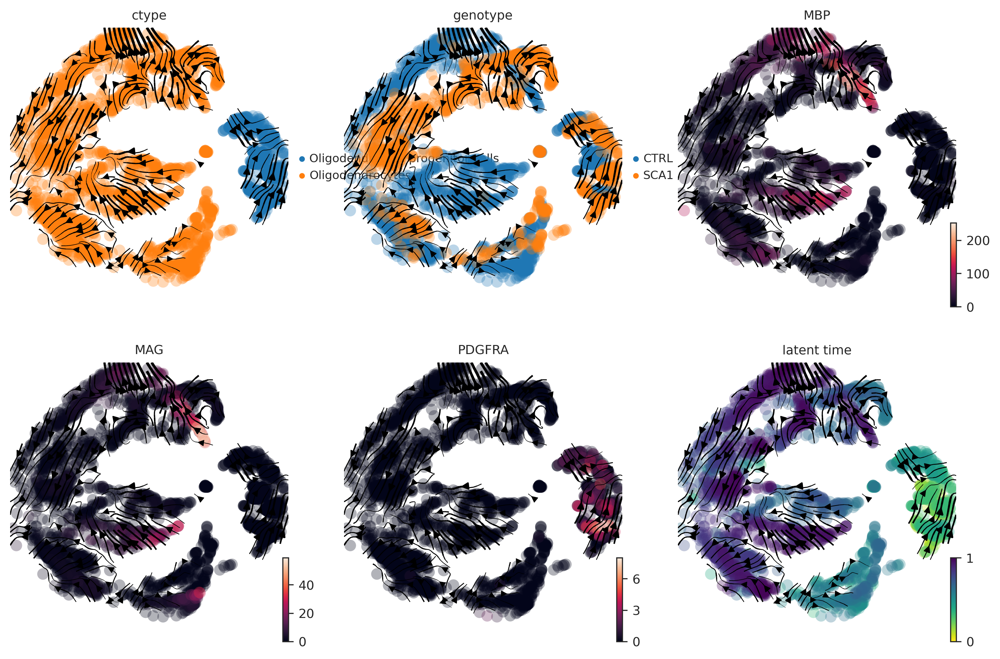

computing PCA
    with n_comps=100
    finished (0:00:16)
computing neighbors
    using 'X_pca' with n_pcs = 100
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.17 seconds.
    Calculating KMeans...
    Calculated KMeans in 16.77 seconds.
  Calculated landmark operator in 18.03 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.56 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.88 seconds.
Calculated PHATE in 23.48 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_t10g1k5d5n100.png


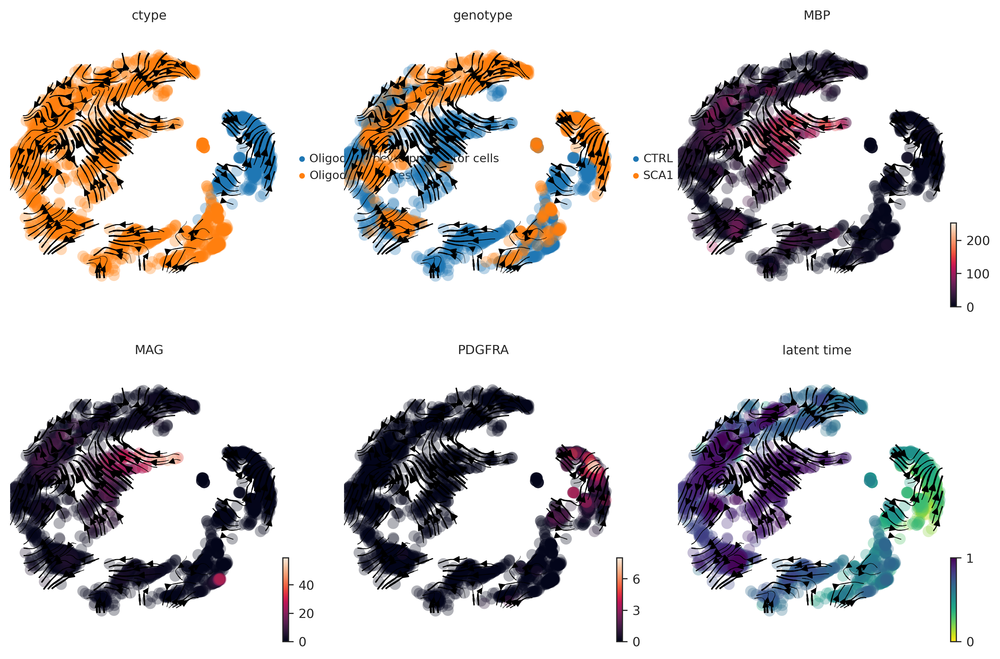

computing PCA
    with n_comps=50
    finished (0:00:10)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.16 seconds.
    Calculating KMeans...
    Calculated KMeans in 13.54 seconds.
  Calculated landmark operator in 14.82 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.56 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.88 seconds.
Calculated PHATE in 20.27 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_t10g1k5d10n50.png


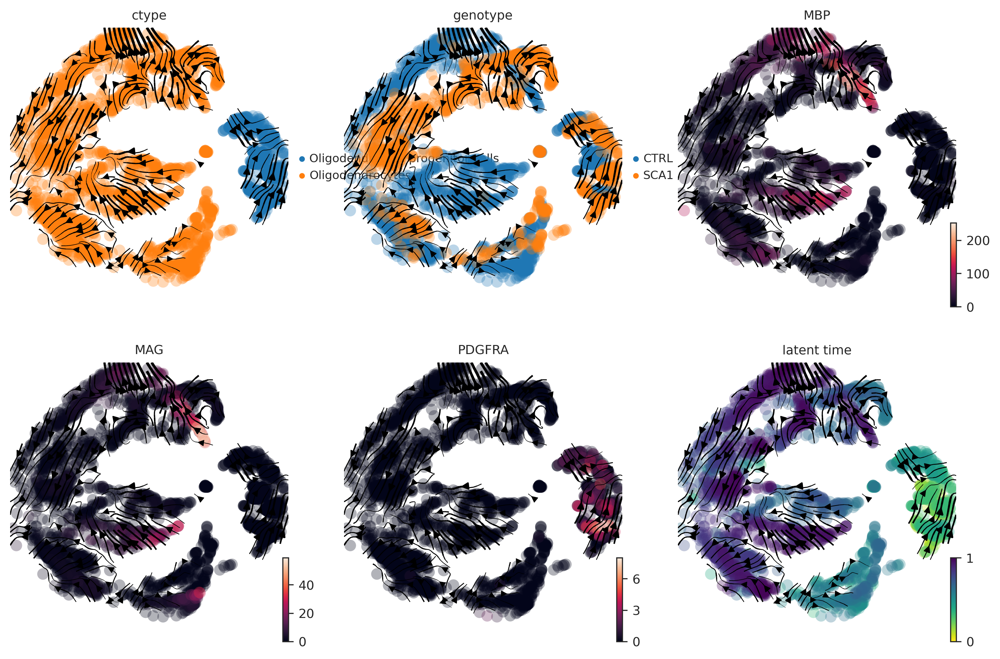

computing PCA
    with n_comps=50
    finished (0:00:08)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.15 seconds.
    Calculating KMeans...
    Calculated KMeans in 14.21 seconds.
  Calculated landmark operator in 15.47 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.96 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.97 seconds.
Calculated PHATE in 21.42 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_t100g1k3d100n50.png


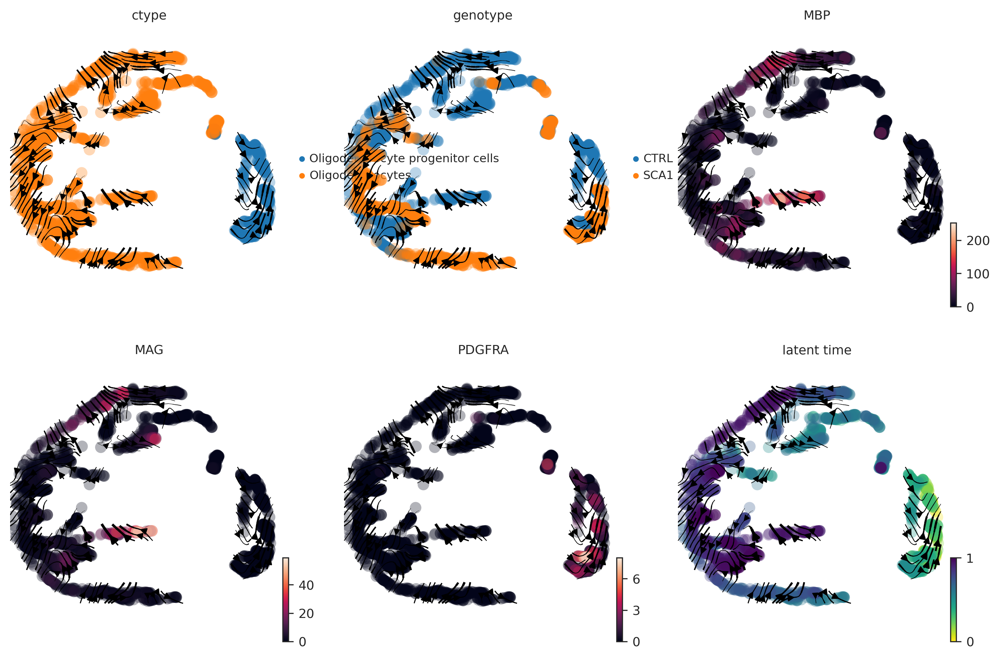

computing PCA
    with n_comps=100
    finished (0:00:20)
computing neighbors
    using 'X_pca' with n_pcs = 100
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.15 seconds.
    Calculating KMeans...
    Calculated KMeans in 16.08 seconds.
  Calculated landmark operator in 17.34 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.76 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.11 seconds.
Calculated PHATE in 23.23 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_t40g1k3d100n100.png


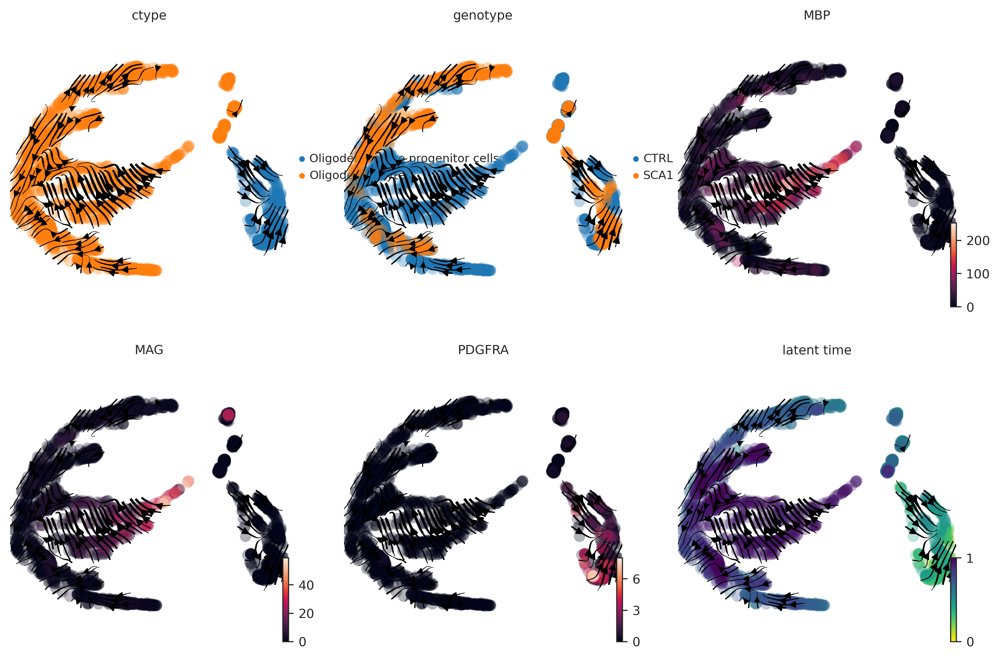

5-min elapsed


In [4]:


# load old
with open ('/home/ngr4/project/scnd/data/processed/hum_olopc_rnavel.h5ad', 'rb') as f:
    tdata = pickle.load(f)
    f.close()
    
# latent time redo 
selection_mode = 'quantile' # 'max', 'quantile', 'random'
idx = np.where(tdata.obs['ctype']=='Oligodendrocyte progenitor cells')[0]
if selection_mode == 'max':
    root_idx = idx[np.argmax(np.asarray(tdata[:, 'PDGFRA'].X.todense()).flatten()[idx])]
elif selection_mode == 'quantile':
    opc_exp = np.asarray(tdata[:, 'PDGFRA'].X.todense()).flatten()[idx]
    root_idx = idx[np.where(opc_exp > np.quantile(opc_exp, 0.9))[0]]
    root_idx = np.random.choice(root_idx, 1).item()
    print('{} root_idx={}'.format(selection_mode, root_idx))
    
    # end cells
    idx = np.where(tdata.obs['ctype']=='Oligodendrocyte progenitor cells')[0]
    opc_exp = np.asarray(tdata[:, 'MAG'].X.todense()).flatten()[idx]
    end_idx = idx[np.where(opc_exp > np.quantile(opc_exp, 0.99))[0]]
#     end_idx = np.random.choice(end_idx, 1).item()
    print('{} end_idx={}'.format(selection_mode, end_idx))
tdata.obs['root']=False
tdata.obs['root'][root_idx]=True
tdata.obs['end']=False
tdata.obs['end'][end_idx]=True
print('root', np.where(tdata.obs['root'])[0])
print('end', np.where(tdata.obs['end'])[0])
tdata.uns['root']=np.where(tdata.obs['root'])[0][0]
tdata.uns['end']=np.where(tdata.obs['end'])[0][0]
scv.tl.recover_latent_time(tdata, 
                           root_key='root', 
                           end_key='end')
    

# main call
tic = time.time()
grid = [
    {'t':10, 'gamma':1, 'knn':5, 'decay':5, 'n_pcs':50,},  # 78
    {'t':10, 'gamma':1, 'knn':5, 'decay':5, 'n_pcs':100,}, # 82
    {'t':10, 'gamma':1, 'knn':5, 'decay':10, 'n_pcs':50,},  # 198
    {'t':100, 'gamma':1, 'knn':3, 'decay':100, 'n_pcs':50,}, # 428
    {'t':40, 'gamma':1, 'knn':3, 'decay':100, 'n_pcs':100,}, # 431
]

for i, params in enumerate(grid):
    tdata = scndutils.phateumap(tdata, recalc_cluster=False, recalc_knn=True, recalc_pca=True, recalc_umap=False,
                                n_pcs=params['n_pcs'], 
                                k=params['knn'], 
                                BBkNN=False, 
                                gamma=params['gamma'], 
                                t=params['t'],
                                decay=params['decay'])
    name = 't{}g{}k{}d{}n{}.png'.format(params['t'], params['gamma'], params['knn'], params['decay'], params['n_pcs'])
    scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time'], 
                                 legend_loc='right_margin', ncols=3, save=name)

    

print('{:.0f}-min elapsed'.format((time.time() - tic)/60))


quantile root_idx=2434
quantile end_idx=[ 537 1421 1464 1905 2099]
root [2434]
computing latent time using root cell 2434 as prior


computing PCA
    with n_comps=100


    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)


    finished (0:00:21)
computing neighbors
    using 'X_pca' with n_pcs = 100
    finished (0:00:02)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 3573 observations.
  Calculating graph and diffusion operator...
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.16 seconds.
    Calculating KMeans...
    Calculated KMeans in 16.03 seconds.
  Calculated landmark operator in 17.25 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.76 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.11 seconds.
Calculated PHATE in 23.14 seconds.
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_noend_t40g1k3d100n100.png


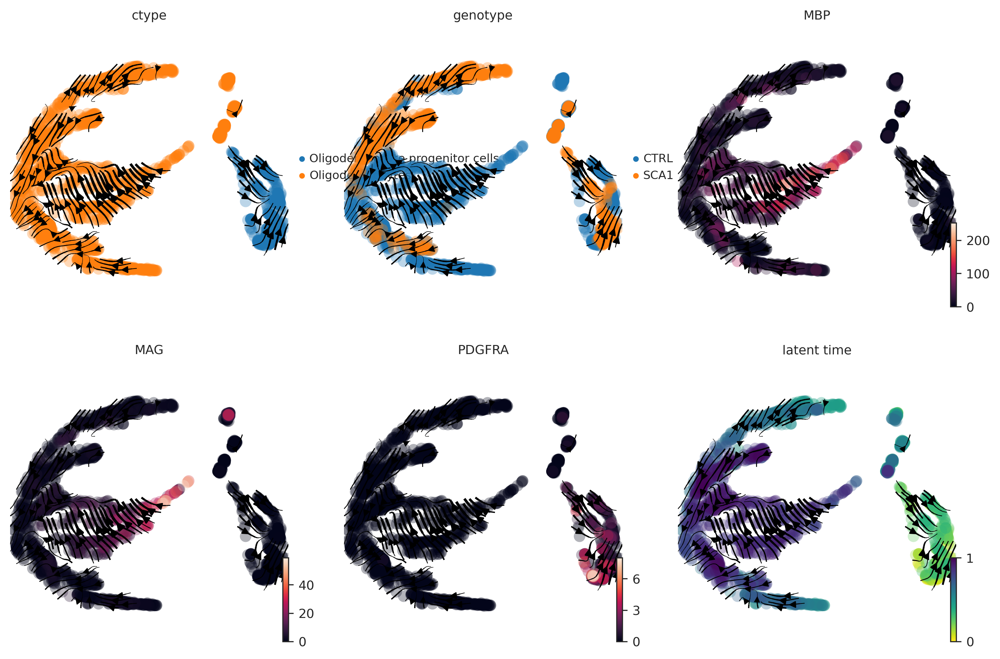

1-min elapsed


In [3]:


# load old
with open ('/home/ngr4/project/scnd/data/processed/hum_olopc_rnavel.h5ad', 'rb') as f:
    tdata = pickle.load(f)
    f.close()
    
# latent time redo 
selection_mode = 'quantile' # 'max', 'quantile', 'random'
end_assign = False
idx = np.where(tdata.obs['ctype']=='Oligodendrocyte progenitor cells')[0]
if selection_mode == 'max':
    root_idx = idx[np.argmax(np.asarray(tdata[:, 'PDGFRA'].X.todense()).flatten()[idx])]
elif selection_mode == 'quantile':
    opc_exp = np.asarray(tdata[:, 'PDGFRA'].X.todense()).flatten()[idx]
    root_idx = idx[np.where(opc_exp > np.quantile(opc_exp, 0.9))[0]]
    root_idx = np.random.choice(root_idx, 1).item()
    print('{} root_idx={}'.format(selection_mode, root_idx))
    
    # end cells
    idx = np.where(tdata.obs['ctype']=='Oligodendrocyte progenitor cells')[0]
    opc_exp = np.asarray(tdata[:, 'MAG'].X.todense()).flatten()[idx]
    end_idx = idx[np.where(opc_exp > np.quantile(opc_exp, 0.99))[0]]
#     end_idx = np.random.choice(end_idx, 1).item()
    print('{} end_idx={}'.format(selection_mode, end_idx))
tdata.obs['root']=False
tdata.obs['root'][root_idx]=True
if end_assign:
    tdata.obs['end']=False
    tdata.obs['end'][end_idx]=True
print('root', np.where(tdata.obs['root'])[0])
if end_assign:
    print('end', np.where(tdata.obs['end'])[0])
    tdata.uns['end']=np.where(tdata.obs['end'])[0][0]
tdata.uns['root']=np.where(tdata.obs['root'])[0][0]
if end_assign:
    scv.tl.recover_latent_time(tdata, 
                               root_key='root', 
                               end_key='end')
else:
    scv.tl.recover_latent_time(tdata, 
                               root_key='root')
    

# main call
tic = time.time()
grid = [
#     {'t':10, 'gamma':1, 'knn':5, 'decay':5, 'n_pcs':50,},  # 78
#     {'t':10, 'gamma':1, 'knn':5, 'decay':5, 'n_pcs':100,}, # 82
#     {'t':10, 'gamma':1, 'knn':5, 'decay':10, 'n_pcs':50,},  # 198
#     {'t':100, 'gamma':1, 'knn':3, 'decay':100, 'n_pcs':50,}, # 428
    {'t':40, 'gamma':1, 'knn':3, 'decay':100, 'n_pcs':100,}, # 431
]

for i, params in enumerate(grid):
    tdata = scndutils.phateumap(tdata, recalc_cluster=False, recalc_knn=True, recalc_pca=True, recalc_umap=False,
                                n_pcs=params['n_pcs'], 
                                k=params['knn'], 
                                BBkNN=False, 
                                gamma=params['gamma'], 
                                t=params['t'],
                                decay=params['decay'])
    name = 'noend_t{}g{}k{}d{}n{}.png'.format(params['t'], params['gamma'], params['knn'], params['decay'], params['n_pcs'])
    scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time'], 
                                 legend_loc='right_margin', ncols=3, save=name)

    

print('{:.0f}-min elapsed'.format((time.time() - tic)/60))


In [15]:
tdata.obs['Sex'] = tdata.obs['batch'].astype(str)
batch2sex = {
    '1-Jan': 'M',
     '122': 'M',
     '132': 'F',
     '14': 'M',
     '1516': 'M',
     '15162': 'M',
     '2-Jan': 'M',
     '3-Jan': 'F',
     '409': 'F',
     '4092': 'F'
}
tdata.obs['Sex'] = tdata.obs['Sex'].map(batch2sex)

In [4]:
# save
with open ('/home/ngr4/project/scnd/data/processed/hum_olopc_rnavel.h5ad', 'wb') as f:
    pickle.dump(tdata, f, protocol=pickle.HIGHEST_PROTOCOL)
    f.close()

In [5]:
# load old
with open ('/home/ngr4/project/scnd/data/processed/hum_olopc_rnavel.h5ad', 'rb') as f:
    tdata = pickle.load(f)
    f.close()
    
tdata

AnnData object with n_obs × n_vars = 3573 × 28311
    obs: 'batch', 'Sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pmito', 'n_genes', 'doublet_score', 'predicted_doublet', 'leiden', 'source', 'ctype_v0', 'ctype_v1', 'ctype', 'sample_batch', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'root', 'end', 'velocity_pseudotime', 'latent_time'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_v

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo__20max.png


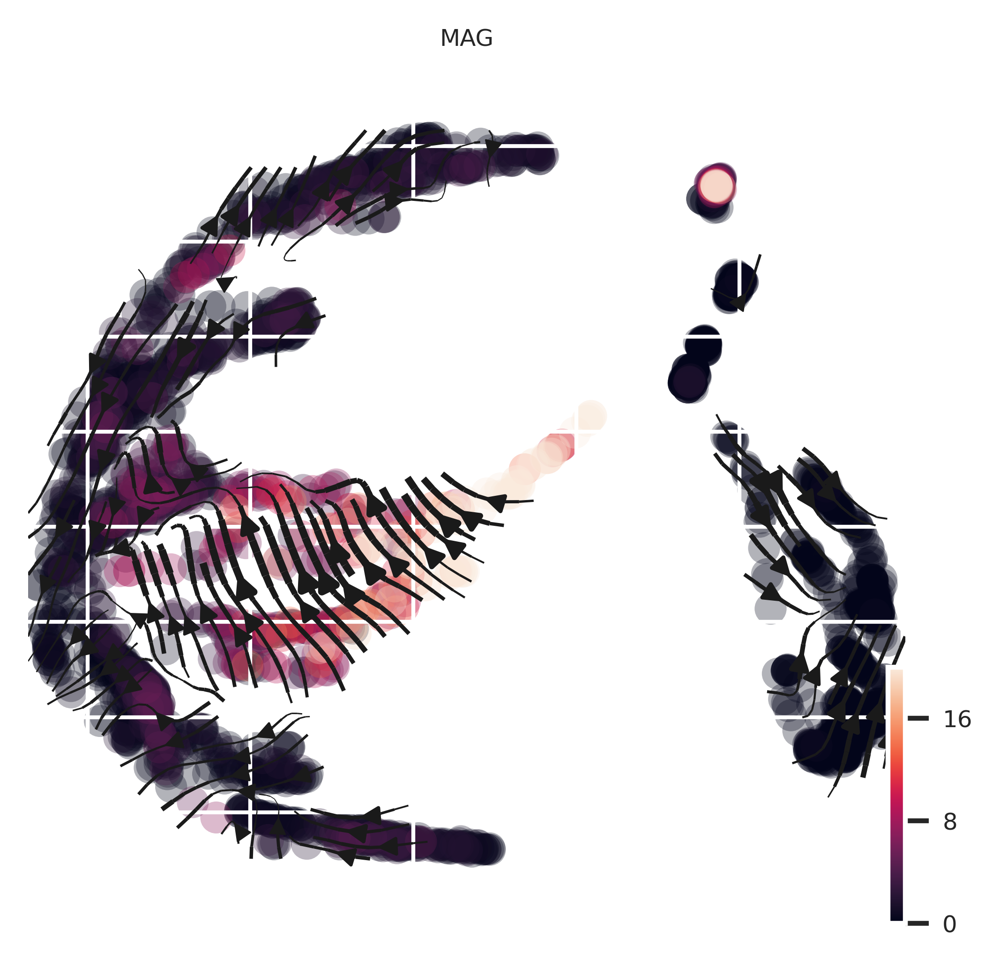

In [30]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['MAG',], 
                                 legend_loc='right_margin', ncols=3, vmax=20, save='_20max.png', dpi=600)

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo__100max.png


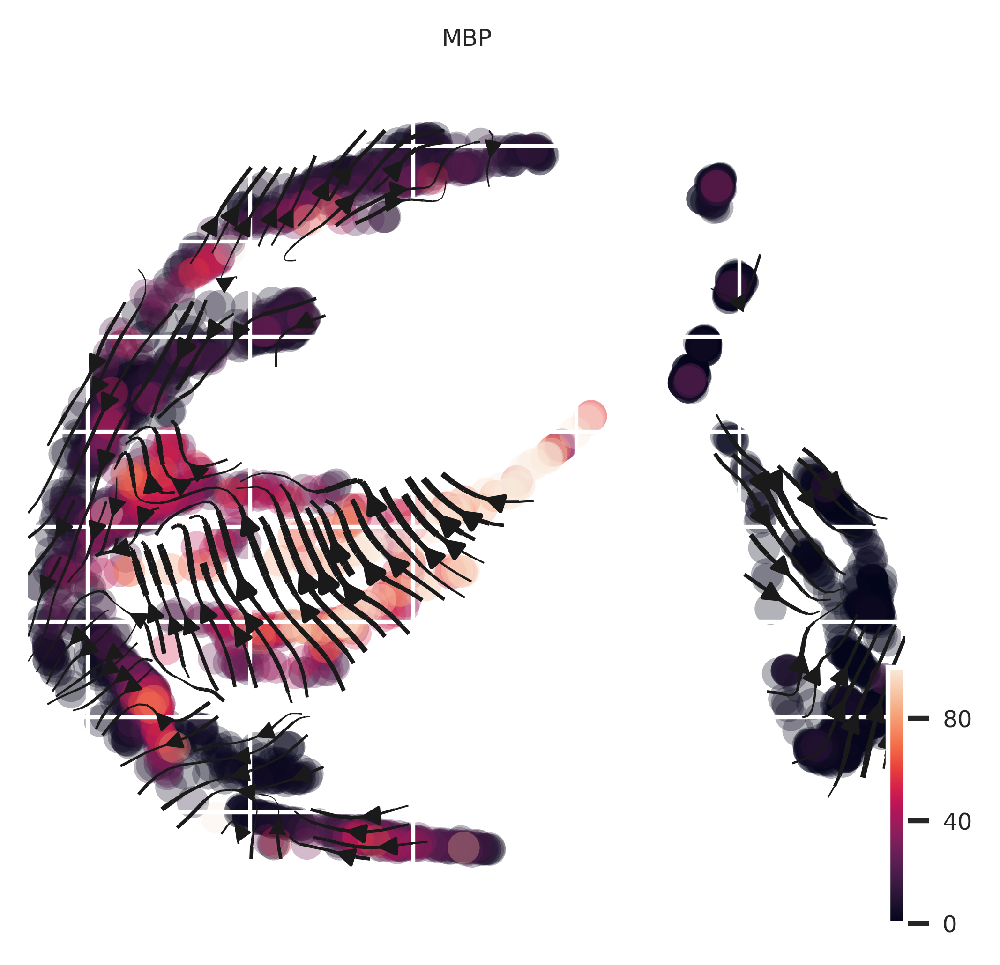

In [39]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['MBP',], 
                                 legend_loc='right_margin', ncols=3, vmax=100, save='_100max.png', dpi=600)

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo__withsex.png


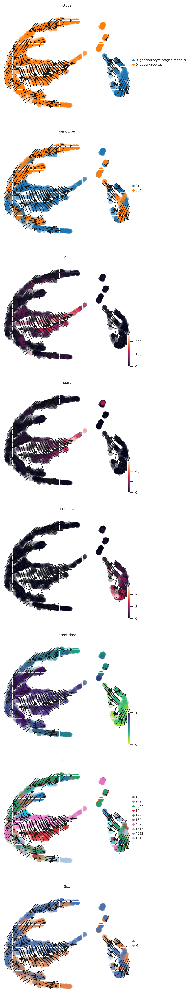

In [35]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time', 'batch', 'Sex'], 
                                 legend_loc='right_margin', ncols=1, save='_withsex.png', dpi=600)

In [10]:
# split by genotype 
wt = tdata[tdata.obs['genotype']=='CTRL', :].copy()
sca1 = tdata[tdata.obs['genotype']=='SCA1', :].copy()

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo__wt.png


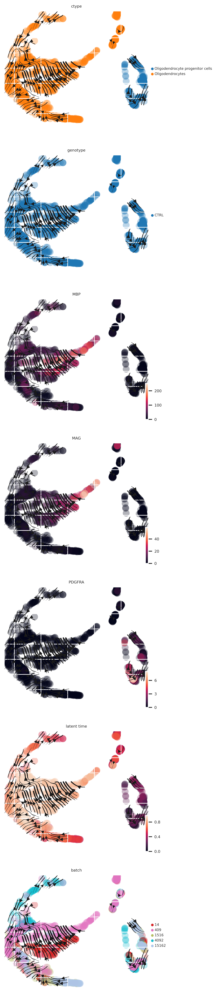

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo__sca1.png


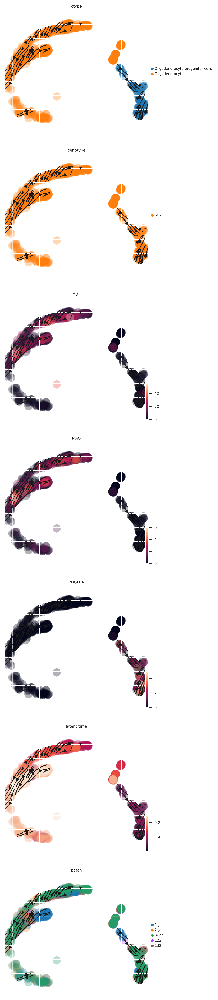

In [36]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time', 'batch'], 
                                 legend_loc='right_margin', ncols=1, save='_wt.png', dpi=600)
scv.pl.velocity_embedding_stream(sca1, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time', 'batch'], 
                                 legend_loc='right_margin', ncols=1, save='_sca1.png', dpi=600)

In [11]:
scv.tl.rank_velocity_genes(wt)
df = scv.DataFrame(wt.uns['rank_velocity_genes']['names'])
df.head()

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,BRINP3,IGSF9B,OPCML,ATP8A2,RBFOX3,ZNF385D,RBFOX3,AKAIN1,FSTL5,GRM3,PALM2-AKAP2,HHIP,JPH1,MAN2A1,CCDC175,CADPS2,SORCS2,ELL2,AKAP12,SERF2
1,PCDH7,TMEM132C,UST,KIAA0513,RELN,PRAG1,GPRIN3,NYAP2,PCLO,PCDH9,SIK3,IQGAP1,PLEKHG1,AL162511.1,WSCD2,EPHA6,DICER1,PHLDB1,FXR1,SELENOW
2,SNTG1,SEMA5A,MEGF11,SPTB,SLIT3,STXBP5L,SPTB,PLCXD3,COL19A1,SPOCK3,CREB5,AGPAT4,ABCA6,ACTN2,TENM1,SELENOW,LANCL1,DICER1,PTGDS,S100A1
3,LUZP2,SHISA9,SLC1A2,FRY,TMEM51-AS1,ABLIM1,CALN1,GABRB2,SYNE1,PEX5L,CDK19,TTLL7,LUCAT1,QKI,RUNX1T1,ARHGAP29,RASGRF2,CNDP1,AMD1,DTNB
4,NXPH1,CSMD2,NTRK3,CAMK1D,SH3GL2,RAB37,SV2B,KCNJ3,RALYL,PIEZO2,KCNK10,CTNNA3,CPEB2,LUCAT1,GRM1,OLFM3,FMNL2,NEK3,GRIA2,LDB3


In [12]:
top_genes = wt.var['fit_likelihood'].sort_values(ascending=False).index[:100]

saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_heatmap__wt.pdf


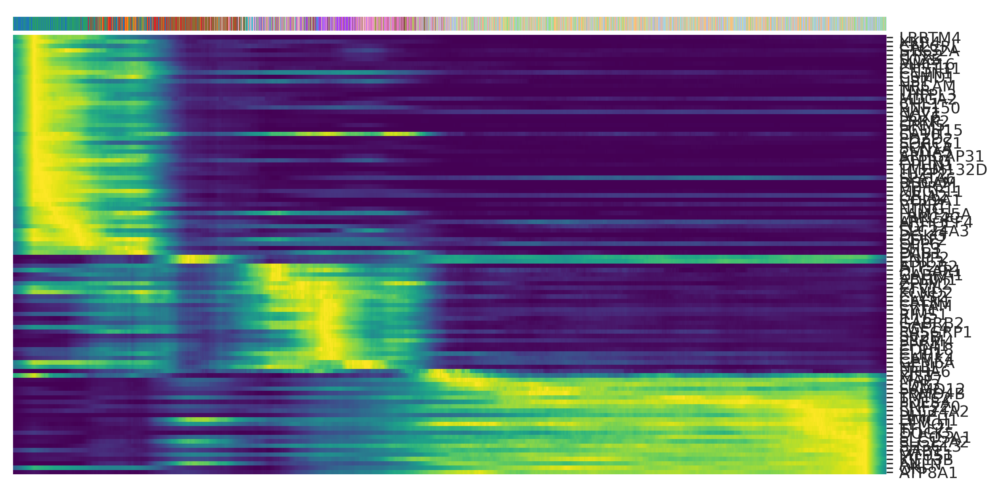

In [13]:
scv.pl.heatmap(wt, var_names=top_genes, sortby='latent_time', n_convolve=100,
#                layer='imputed',
               col_color='velocity_clusters',
               colorbar=True,
#             color_map='viridis_r',
               yticklabels=True,
               save='_wt.pdf',
              )

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
saving figure to file /home/ngr4/project/scnd/results/hum_redo_phateparamscan/scvelo_heatmap__sca1.pdf


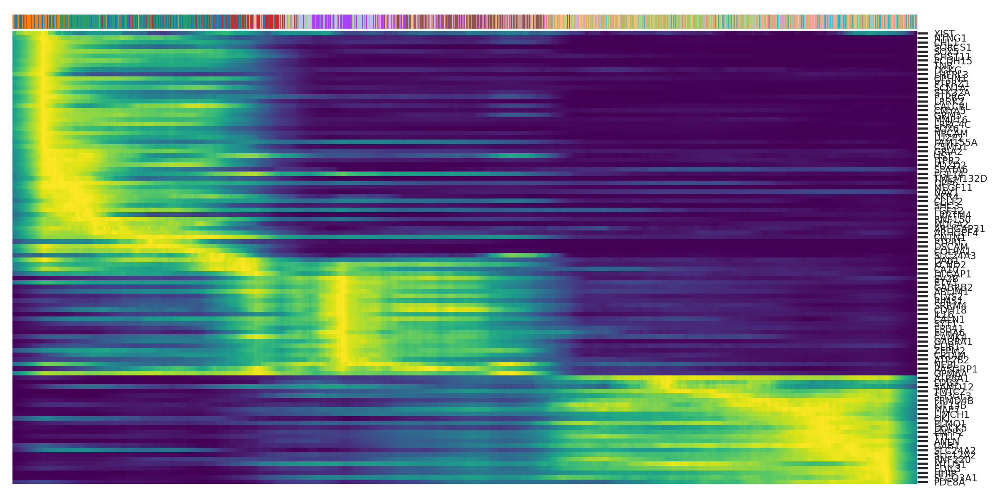

In [14]:
scv.tl.rank_velocity_genes(sca1)
top_genes_sca1 = sca1.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.pl.heatmap(sca1, var_names=top_genes_sca1, sortby='latent_time', 
               col_color='velocity_clusters',
               n_convolve=100,
#                layer='imputed',
               colorbar=True,
#                            color_map='viridis_r',
               yticklabels=True,
               font_scale=0.5,
               save='_sca1.pdf',
              )

In [28]:
top_genes_WT = wt.var['fit_likelihood'].sort_values(ascending=False).index[:100]

In [29]:
fname = '/home/ngr4/project/scnd/results/hum_redo_dyngenes_top100_wt.csv'
pd.DataFrame(np.asarray(wt[:, top_genes_WT].X.todense()), index=wt.obs.index.to_list(), columns=top_genes).to_csv(fname)

In [27]:
fname = '/home/ngr4/project/scnd/results/hum_redo_dyngenes_top100_sca1.csv'
pd.DataFrame(np.asarray(sca1[:, top_genes].X.todense()), index=sca1.obs.index.to_list(), columns=top_genes).to_csv(fname)

In [26]:
np.asarray(sca1[:, top_genes].X.todense())

(1473, 100)